# Description

**Author:** Anna Luisa Hemshorn de Sánchez

**Affiliation:** (1) Department of Earth Sciences, VU Amsterdam, (2) Institute of Environmental Studies (IVM), VU Amsterdam, (3) Deltares

**Contact:** a.l.hemshorndesanchez@vu.nl

**Version:** V1

**Date:** Oct 20, 2025

**Description:** Data used in this notebook is obtained from: do Nascimento, T.V.M., Rudlang, J., Höge, M. et al. EStreams: An integrated dataset and catalogue of streamflow, hydro-climatic and landscape variables for Europe. _Sci Data_ 11, 879 (2024). https://doi.org/10.1038/s41597-024-03706-1

In this code we analyse the relationship between annual climate sensitivities of streamflow metrics and catchment characteristicts. 

# Import packages

In [1]:
from pathlib import Path
import numpy as np
import pandas as pd
import geopandas as gpd
from shapely.wkt import loads
from functools import reduce
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split, cross_val_score, GridSearchCV
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.inspection import permutation_importance
from statsmodels.stats.outliers_influence import variance_inflation_factor
import statsmodels.api as sm
import shap
import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec
from matplotlib.colors import LogNorm, Normalize
from matplotlib.colorbar import Colorbar
from matplotlib.patches import Patch
import matplotlib.ticker as ticker
import seaborn as sns
from cmcrameri import cm # to be cited
import cartopy.crs as ccrs
from mpl_toolkits.axes_grid1 import make_axes_locatable
from matplotlib.ticker import FixedLocator, FixedFormatter

# Define file paths

In [2]:
# Get main directories
nb_dir = Path.cwd()
parent_dir = nb_dir.parent.parent.parent.parent
fp = parent_dir / "Data/Europe/estreams/EStreams_v1.3/"

# Input directories and filepaths
fp_gauges = fp / "streamflow_gauges/estreams_gauging_stations.csv"
fp_met = fp / "meteorology/" # contains: estreams_meteorology_{basin_id}.csv
fp_hydsig = fp / "hydroclimatic_signatures/estreams_hydrometeo_signatures.csv"
fp_shp_gau = fp / "shapefiles/estreams_gauging_stations.shp"
fp_shp_cat = fp / "shapefiles/estreams_catchments.shp"
fp_attr_stat = fp / "attributes/static_attributes/" # contains: estreams_{attribute_type}_attributes.csv
fp_attr_temp = fp / "attributes/temporal_attributes/" # contains: estreams_{attribute_type}_[time_scale].csv

# Output directories
fp_gh = parent_dir / "Code/GitHub/streamflow_sensitivity_europe/"
fp_processed = fp_gh / "data/processed/" 
fp_figures = fp_gh / "figures/"

# Read in data

In [3]:
basin_id_sel = pd.read_csv(fp_processed/"01_selection/basin_id_sel.csv", index_col=0)['basin_id']
print('Amount of gauges: ', len(basin_id_sel))

europe = gpd.read_file(parent_dir/"Data/Admin/ne_50m_admin_0_countries/ne_50m_admin_0_countries.shp") #CNTR_BN_01M_2020_3035.shp/CNTR_BN_01M_2020_3035.shp')#
europe = europe[(europe['CONTINENT'].str.contains('Europe', case=False, na=False)) |
                ((europe.geometry.bounds['minx'] >= -10) &     
                 (europe.geometry.bounds['maxx'] <= 50) &
                 (europe.geometry.bounds['miny'] >= 30) & 
                 (europe.geometry.bounds['maxy'] <= 70))] #europe = europe.cx[-10:50, 30:70] #europe = europe[europe['CONTINENT'] == 'Europe']

# Overview DataFrame that is used to store all new results into
result_df = pd.read_csv(fp_processed/f"01_selection/gauges_metadata.csv", index_col='basin_id')
result_df['geometry'] = result_df['wkt_geometry'].apply(loads)
result_gdf = gpd.GeoDataFrame(result_df, geometry='geometry')
result_gdf.set_crs("EPSG:4326", inplace=True)
result_gdf = result_gdf.sort_index()
result_gdf = result_gdf.drop(columns=['lon_snap', 'lat_snap', 'lon', 'lat', 'elevation', 'area_estre', 'start_date', 'end_date', 'gauges_ups'])
result_gdf

Amount of gauges:  8307


,gauge_id,gauge_name,gauge_coun,river,geometry,wkt_geometry
basin_id,,,,,,
AT000001,200014,Bangs,AT,Rhein,POINT (9.53484 47.27375),POINT (9.53483518 47.27374823)
AT000002,200048,Schruns (Vonbunweg),AT,Litz,POINT (9.91368 47.08030),POINT (9.913676603000001 47.08030125)
AT000003,231662,Loruens-Aeule,AT,Ill,POINT (9.84777 47.13282),POINT (9.847765104 47.13282061)
AT000004,200592,Kloesterle (OEBB),AT,Alfenz,POINT (10.06184 47.12899),POINT (10.06184292 47.12899384)
AT000005,200097,Buers (Bruecke L82),AT,Alvier,POINT (9.80267 47.15077),POINT (9.802668269 47.15077039)
...,...,...,...,...,...,...
UAGR0014,6680802,KAKHOVSKOYE VODOKHRANILISHCHE GES,UA,DNIEPER,POINT (33.18000 46.77000),POINT (33.18 46.77)
UAGR0016,6681500,NOVOGOROZHENOYE,UA,INHUL,POINT (32.35000 47.51667),POINT (32.35 47.516667)
UAGR0017,6682300,BASHTANOVKA,UA,KACHA,POINT (33.89474 44.69188),POINT (33.89473859 44.69188354)


In [4]:
# Multiple linear regression
result_df_seasonal_mlr = pd.read_csv(fp_processed/"03_sensitivities/02_seasonal/seasonal_PelasTsens_summary_mlr.csv", index_col='basin_id', low_memory=False)
result_df_seasonal_mlr['geometry'] = result_df_seasonal_mlr['wkt_geometry'].apply(loads)
result_gdf_seasonal_mlr = gpd.GeoDataFrame(result_df_seasonal_mlr, geometry='geometry')
result_gdf_seasonal_mlr.set_crs("EPSG:4326", inplace=True)
result_gdf_seasonal_mlr = result_gdf_seasonal_mlr.sort_index()
result_gdf_seasonal_mlr = result_gdf_seasonal_mlr.drop(columns=[col for col in result_gdf_seasonal_mlr.columns if col.endswith(('intercept', 'r2'))])

In [5]:
veg = pd.read_csv(fp_attr_stat/"estreams_vegetation_attributes.csv", index_col='basin_id')[['lai_mean']] #,'ndvi_mean'
                                                                                                
hyd = pd.read_csv(fp_attr_stat/"estreams_hydrology_attributes.csv", index_col='basin_id')[['dam_num', #'res_num',
                                                                                           'res_tot_sto',#'lakes_num','lakes_tot_area',
                                                                                           'lakes_tot_vol']]
gauges = pd.read_csv(fp_gauges, index_col='basin_id')[[#'elevation', 
                                                       'area_estreams']]

hydsig = pd.read_csv(fp_hydsig, index_col='basin_id')[['baseflow_index', #'slope_sawicz', 
                                                       #'q_runoff_ratio', #'hfd_mean', 'hfd_std', 'q_5', 'q_95', 'hq_freq',
                                                       #'hq_dur', 'lq_freq', 'lq_dur', 'zero_q_freq', 'p_mean', 'pet_mean',
                                                       'aridity', 'p_seasonality', 'frac_snow', #'hp_freq', 'hp_dur', 
                                                       #'hp_time', (string format)
                                                       #'lp_freq', 'lp_dur', #'lp_time' (string format)
                                                      ]]
geo = pd.read_csv(fp_attr_stat/"estreams_geology_attributes.csv", index_col='basin_id')[[
                                                       #'lit_fra_ev', 'lit_fra_ig', 'lit_fra_mt', 'lit_fra_nd', 'lit_fra_pa',
                                                       #'lit_fra_pb', 'lit_fra_pi', 'lit_fra_py', 'lit_fra_sc', 'lit_fra_sm',
                                                       #'lit_fra_ss', 'lit_fra_su', 'lit_fra_va', 'lit_fra_vb', 'lit_fra_vi',
                                                       #'lit_fra_wb', 'lit_dom',  
                                                        'bedrk_dep']]
soil = pd.read_csv(fp_attr_stat/"estreams_soil_attributes.csv", index_col='basin_id')[['soil_fra_sand_mean', 
                                                                                            'soil_fra_clay_mean', 
                                                                                            'soil_fra_grav_mean', 
                                                                                            'soil_oc_mean',
                                                                                            'root_dep_mean',
                                                                                            #'soil_tawc_mean',
                                                                                            'soil_bd_mean']]
topo = pd.read_csv(fp_attr_stat/"estreams_topography_attributes.csv", index_col='basin_id')[[#'ele_mt_mean', 
                                                                                            'slp_dg_mean', 
                                                                                            'elon_ratio', 
                                                                                            #'flat_area_fra', 
                                                                                            #'steep_area_fra', 
                                                                                            'strm_dens']]
lc = pd.read_csv(fp_attr_temp/"estreams_landcover_attributes.csv", index_col='basin_id')
irr = pd.read_csv(fp_attr_temp/"estreams_irrigation_yearly.csv", index_col='date')[basin_id_sel].T
irr['irr_mean'] = irr[[1900,1910,1920,1930,1940,1950,1960,1970,1980,1985,1990,1995,2000,2005]].mean(axis=1).round(3)
irr.index.name = 'basin_id'
irr = irr[['irr_mean']]

# Pre-process data

Averaging land cover and irrigation data over the entire period.

In [6]:
# Initialize an empty dataframe to store the results
lc_means = pd.DataFrame()
lc_means.index = lc.index

# Artifical areas
## List of all LULC classes that fall under 'artificial areas'
artif_classes = ['111', # Continuous urban fabric
                  '112', # Discontinuous urban fabric
                  '121', # Industrial or commercial units
                  '122', # Road and rail networks and associated land
                  '123', # Port areas
                  '124', # Airports
                  '131', # Mineral extraction sites
                  '132', # Dump sites
                  '133', # Construction sites
                  '141', # Green urban areas
                      '142'] # Sport and leisure facilities
years = [1990, 2000, 2006, 2012, 2018]

## Loop through each artificial land use class
for lc_cls in artif_classes:
    # Collect columns for this class across all years
    cols = [f'lulc_{year}_{lc_cls}' for year in years if f'lulc_{year}_{lc_cls}' in lc.columns]
    
    # Compute the row-wise mean across years for this class
    lc_means[f'lulc_{lc_cls}_mean'] = lc[cols].mean(axis=1)

## Sum all class-wise means to get the total "artificial" mean sum
lc_means['lulc_artif_mean'] = lc_means[[f'lulc_{lc_cls}_mean' for lc_cls in artif_classes]].sum(axis=1).round(3)


# Agricultural areas
## List of all LULC classes that fall under 'artificial areas'
argri_classes = ['211', # Non-irrigated arable land
                       '212', # Permanently irrigated land
                       '213', # Rice fields
                       '221', # Vineyards
                       '222', # Fruit trees and berry plantations
                       '223', # Olive groves
                       '231', # Pastures
                       '241', # Annual crops associated with permanent crops
                       '242', # Complex cultivation patterns
                       '243', # Land principally occupied by agriculture, with significant areas of natural vegetation
                       '244', # Agro-forestry areas
                      ]

## Loop through each artificial land use class
for lc_cls in argri_classes:
    # Collect columns for this class across all years
    cols = [f'lulc_{year}_{lc_cls}' for year in years if f'lulc_{year}_{lc_cls}' in lc.columns]
    
    # Compute the row-wise mean across years for this class
    lc_means[f'lulc_{lc_cls}_mean'] = lc[cols].mean(axis=1)

## Sum all class-wise means to get the total "artificial" mean sum
lc_means['lulc_agri_mean'] = lc_means[[f'lulc_{lc_cls}_mean' for lc_cls in argri_classes]].sum(axis=1).round(3)

In [7]:
cc_list = [veg, hyd, 
           gauges, geo, #gauges_sel #contains too many nans
           hydsig, soil, topo, lc_means, irr]  # List of dataframes to merge
cc_df = reduce(lambda left, right: left.merge(right, on='basin_id', how='outer'), cc_list)
cc_df = cc_df[cc_df.index.isin(basin_id_sel)]

In [8]:
# Calculate annual streamflow sums to have lake volumes divided by annual Q sums to have a better idea of the share of the lake volume.
MON_str = 'OCT' #'SEP'
Qmean_hyr = pd.read_csv(fp_processed/f"02_temporal_stats/02_hyearly/hyearly_A-{MON_str}_Qmean.csv", index_col=0, parse_dates=[0])[basin_id_sel]
Qmean_hyr_sum = Qmean_hyr.mean()*365/1000 #transform annual mean in mm/d to annual sums in m/a.
cc_df['Qspec_hyr_sum'] = Qmean_hyr_sum

In [9]:
cc_df['lakes_rel_vol'] =  (cc_df['lakes_tot_vol']*(1e6))/ (cc_df['Qspec_hyr_sum'] * cc_df['area_estreams']*1e6) #divides lake_vol (10^6 m^3*1e6=m^3) by the product of spec. annual flow sum (m/a) and the area (km^2*1e6=km^2). The unit of lakes_rel is (a).
cc_df['res_rel_vol'] =  (cc_df['res_tot_sto']*(1e6))/ (cc_df['Qspec_hyr_sum'] * cc_df['area_estreams']*1e6)

In [10]:
#cc_df['area_estreams'] = np.log(cc_df['area_estreams'])
#cc_df['aridity'] = np.log(cc_df['aridity'])
len(cc_df.index)

8307

Random Forest Regressor does not accept nans. So we identify which variables contains most nans or if the nan catchments can be dropped.

In [11]:
cc_df_nan_count = cc_df.isna().sum()
with pd.option_context('display.max_rows', None):
    print(cc_df_nan_count)

lai_mean                 1
dam_num                  0
res_tot_sto           6836
lakes_tot_vol            0
area_estreams            0
bedrk_dep                0
baseflow_index          40
aridity                  0
p_seasonality            0
frac_snow                0
soil_fra_sand_mean       0
soil_fra_clay_mean       0
soil_fra_grav_mean       0
soil_oc_mean             0
root_dep_mean            0
soil_bd_mean             0
slp_dg_mean              0
elon_ratio               0
strm_dens                0
lulc_111_mean           61
lulc_112_mean           61
lulc_121_mean           61
lulc_122_mean           61
lulc_123_mean           61
lulc_124_mean           61
lulc_131_mean           61
lulc_132_mean           61
lulc_133_mean           61
lulc_141_mean           61
lulc_142_mean           61
lulc_artif_mean          0
lulc_211_mean           61
lulc_212_mean           61
lulc_213_mean           61
lulc_221_mean           61
lulc_222_mean           61
lulc_223_mean           61
l

The problem with the reservoir data (res_tot_sto) is that there are many nans (6834 of 8305). The random forest model cannot work with nans. A nan in the dataset could either mean that there is no storage or that it has not been recorded. If we only work with the non nan value the reservoir becomes a quite important parameter. If we want to use more data we would need to set the nans to 0 which may not be accurate.

In [12]:
cc_df['res_tot_sto'] = cc_df['res_tot_sto'].fillna(0)
cc_df['res_rel_vol'] = cc_df['res_rel_vol'].fillna(0)

In [13]:
cc_df = cc_df.drop(columns=['Qspec_hyr_sum',
                            'dam_num', # dropped because too related to storage volume,
                            #'soil_fra_clay_mean', # dropped because too related to sand fraction
                            'res_tot_sto', # dropped because too related to area
                            'lakes_tot_vol', # dropped because it is similar information as lakes_rel_vol
                            #'elevation', #'river',
                            #'slope_sawicz', 
                            #'ndvi_12', 
                            #'hq_freq', 
                            #'hq_dur', 
                            #'lq_freq', 
                            #'lq_dur', 
                            #'lakes_tot_vol',
                            #'irr_mean',
                            'lulc_111_mean','lulc_112_mean','lulc_121_mean' , 'lulc_122_mean', 'lulc_123_mean', 'lulc_124_mean','lulc_131_mean','lulc_132_mean','lulc_133_mean' ,'lulc_141_mean','lulc_142_mean', #artif subclasses
                            'lulc_211_mean','lulc_212_mean','lulc_213_mean','lulc_221_mean','lulc_222_mean','lulc_223_mean','lulc_231_mean','lulc_241_mean','lulc_242_mean','lulc_243_mean','lulc_244_mean'# agri sub classes
                           ])
cc_df = cc_df.dropna() #subset=['colA', 'colB']

In [14]:
# Settings to run the model including or excluding baseflow_index or running it exclusively with baseflow_index
#cc_df = cc_df[['baseflow_index']]
#cc_df = cc_df.dropna()
#cc_df = cc_df.drop(columns=['baseflow_index'])
len(cc_df.index)

7595

In [15]:
param_dict = {'q_runoff_ratio': 'Q runoff ratio [-]',
              'baseflow_index': 'baseflow index [-]', #'ratio of mean daily baseflow\nto mean daily Q [-]', 
              'q_elas_Sankarasubramanian': 'Q elasticity to P [-]', 
              'p_seasonality': 'P seasonality [-]',
              'aridity': 'aridity (Ep/P) [-]',
              'area_estreams':'catchment area [$km^2$]',
              'frac_snow': 'snow fraction [-]', 
              'lai_mean': 'LAI [-]', #'mean LAI [-]'
              'ndvi_mean': 'NDVI [-]', #'mean NDVI [-]'
              'soil_fra_sand_mean': 'sand fraction [%]', #'mean sand fraction [%]', 
              'soil_fra_clay_mean': 'clay fraction [%]', #'mean clay fraction [%]'
              'soil_fra_grav_mean': 'gravel fraction [%]', #'mean gravel fraction [%]'
              'soil_oc_mean': 'soil OC [%]', #'mean soil OC [%]'
              'root_dep_mean': 'depth avail. for roots [cm]', #'depth avail.for\nroots [cm]' #'mean root depth avail.\nfor roots [cm]'
              'soil_tawc_mean': 'total available water content [mm]', # 'total available\nwater content [mm]#'mean total available\nwater content [mm]
              'soil_bd_mean': 'bulk density [g/$cm^3$]', #'mean bulk density [g/$cm^3$]'
              'bedrk_dep': 'depth to bedrock [m]',
              'ele_mt_mean': 'elevation [m]', #'mean elevation [m]'
              'slp_dg_mean': 'slope degree [°]', #'mean slope degree [°]'
              'elon_ratio': 'elongation ratio [-]', # ratio between the diameter of a circle with the same area as the masin and the maximum length of the basin
              'flat_area_fra': 'flat area fraction [%]', 
              'steep_area_fra': 'steep area fraction [%]',
              'strm_dens': 'stream density\n[1000km/$km^2$]', #'stream density\n[1000km/$km^2$]'
              'dam_num': 'number of dams upstream [-]', #'number of dams\nupstream [-]'
              'res_num': 'number of reservoirs\nupstream [-]', 
              'res_tot_sto': 'total upstream storage\nvolume [$10^6 m^3$]', 
              'lakes_tot_vol': 'total upstream volume\n(HydroLakes) [$10^6 m^3$]',
              'lakes_rel_vol': 'lake volume relative\nto annual Q sum [$a$]', #'lake volume relative\nto annual Q sum [$a$]
              'res_rel_vol': 'reservoir volume relative\nto annual Q sum [$a$]',
              'lulc_artif_mean': 'artifical land cover [-]', # 'artifical\nland cover [-]'#'mean artifical land cover [-]'
              'lulc_agri_mean': 'agricultural land cover [-]', # 'agricultural\nland cover [-]' #'mean agricultural land\ncover [-]'
              'irr_mean': 'mean area equipped for irrigation [$km^2$]'
             }

# Reverse mapping: pretty name → raw feature name
rev_param_dict = {v: k for k, v in param_dict.items()}

#test = rev_param_dict.get('lake volume relative\nto annual Q sum [$a$]', 'FAIL')
#test

In [16]:
feature_class_dict = {
    'q_runoff_ratio': 'hydrology',
    'baseflow_index': 'hydrology', 
    'q_elas_Sankarasubramanian': 'hydrology', 
    'lakes_tot_vol': 'hydrology',
    'lakes_rel_vol': 'hydrology',

    'aridity': 'climate',
    'frac_snow': 'climate', 
    'p_seasonality': 'climate',

    'ele_mt_mean': 'topography',
    'slp_dg_mean': 'topography',
    'elon_ratio': 'topography',
    'flat_area_fra': 'topography', 
    'steep_area_fra': 'topography',
    'area_estreams': 'topography',
    'strm_dens': 'topography',

    'soil_fra_sand_mean': 'soil property', 
    'soil_fra_clay_mean': 'soil property', 
    'soil_fra_grav_mean': 'soil property',
    'soil_oc_mean': 'soil property', 
    'root_dep_mean': 'soil property', 
    'soil_tawc_mean': 'soil property', 
    'soil_bd_mean': 'soil property',
    'bedrk_dep': 'soil property',     

    'lai_mean': 'vegetation', 
    'ndvi_mean': 'vegetation',

    'lulc_agri_mean': 'human influence', 

    'lulc_artif_mean': 'human influence',
    'irr_mean': 'human influence',
    'dam_num': 'human influence', 
    'res_num': 'human influence',
    'res_tot_vol': 'human influence',
    'res_rel_vol': 'human influence',
}

class_color_dict = {
    'climate': '#4791FF', #'sunflowerblue',  
    'soil property': '#B9918D', #'brown',      
    'vegetation': '#5B9A6E', #'forestgreen',  
    'topography': '#CADBC0', #'purple',     
    'human influence': '#E2EF2E', #'grey',       
    'hydrology': '#00317A'  #'darkblue'
}

In [17]:
met_dict = {'P': 'P_elas', 'T': 'T_sens'}

# Check for collinearity 

We make a correlation heatmap for the three models (mean, max and min flow), to see which pairs of variables are correlated with more than 0.8. For those pairs we exclude one of th pair.

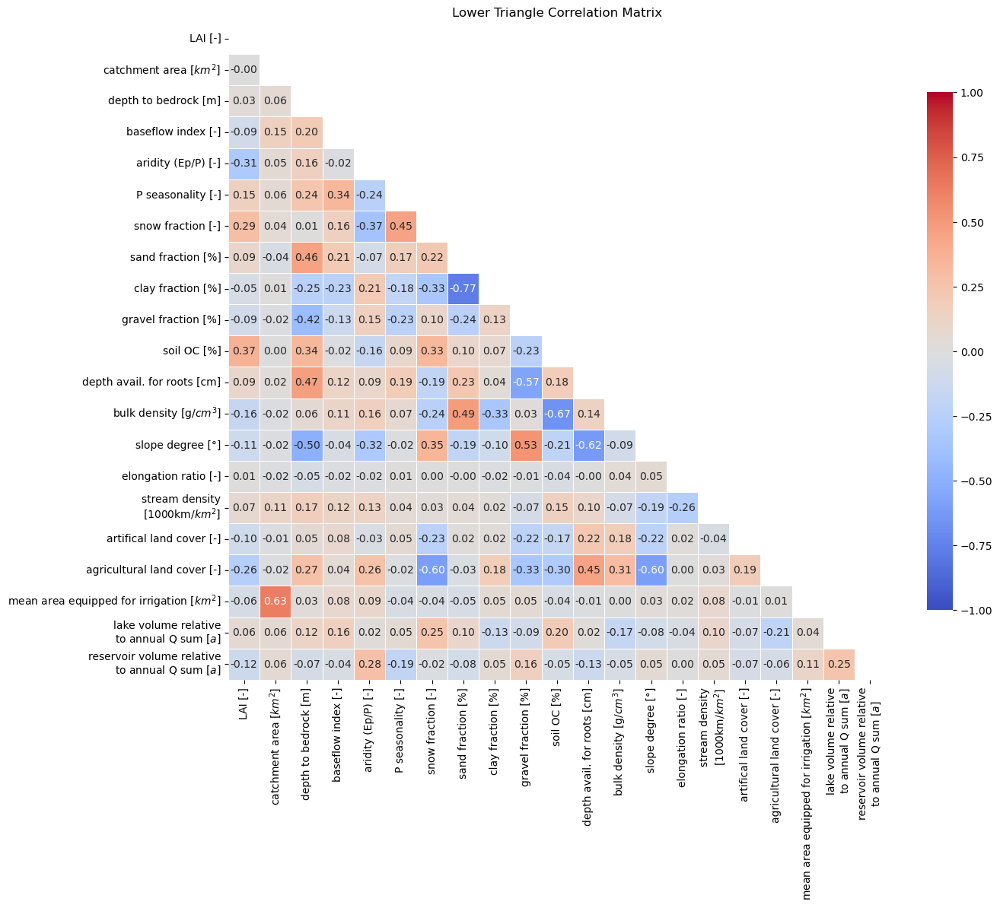

In [18]:
def check_collinearity(elas, cc, Q_str, P_str, T_str, met_type, t_scale):
    elas = elas[['wkt_geometry', 
                 str(Q_str+P_str+T_str+'_'+t_scale+'-'+met_dict[met_type]), 
                 str(Q_str+P_str+T_str+'_'+t_scale+'-'+met_type+'_pval')]]
    
    # Extract only statistical significant ones
    elas = elas[elas[str(Q_str+P_str+T_str+'_'+t_scale+'-'+met_type+'_pval')]<0.05]
    
    elas = elas.dropna(subset=[str(Q_str+P_str+T_str+'_'+t_scale+'-'+met_dict[met_type])]) 
    elas, cc = elas.align(cc, join='inner', axis=0)
    X = cc # predictors (features)
    y = elas[str(Q_str+P_str+T_str+'_'+t_scale+'-'+met_dict[met_type])] # target variable
    
    # Compute the correlation matrix
    corr_matrix = X.corr().round(2)
    corr_matrix = corr_matrix.rename(index=param_dict, columns=param_dict)


    # Create a mask for the upper triangle
    mask = np.triu(np.ones_like(corr_matrix, dtype=bool))

    # Set up the matplotlib figure
    plt.figure(figsize=(14, 12))

    # Draw the heatmap with the mask and the correlation values
    sns.heatmap(corr_matrix, mask=mask, annot=True, fmt=".2f", cmap='coolwarm', vmin=-1, vmax=1,
                square=True, linewidths=0.5, cbar_kws={"shrink": 0.75})

    plt.title("Lower Triangle Correlation Matrix")
    plt.tight_layout()
    plt.show()

    return 

# QmeanPmeanTmean_Pelas
check_collinearity(elas=result_df_seasonal_mlr, cc=cc_df, Q_str='Qmean', P_str='Pmean', T_str='Tmean', met_type='P', t_scale='A')

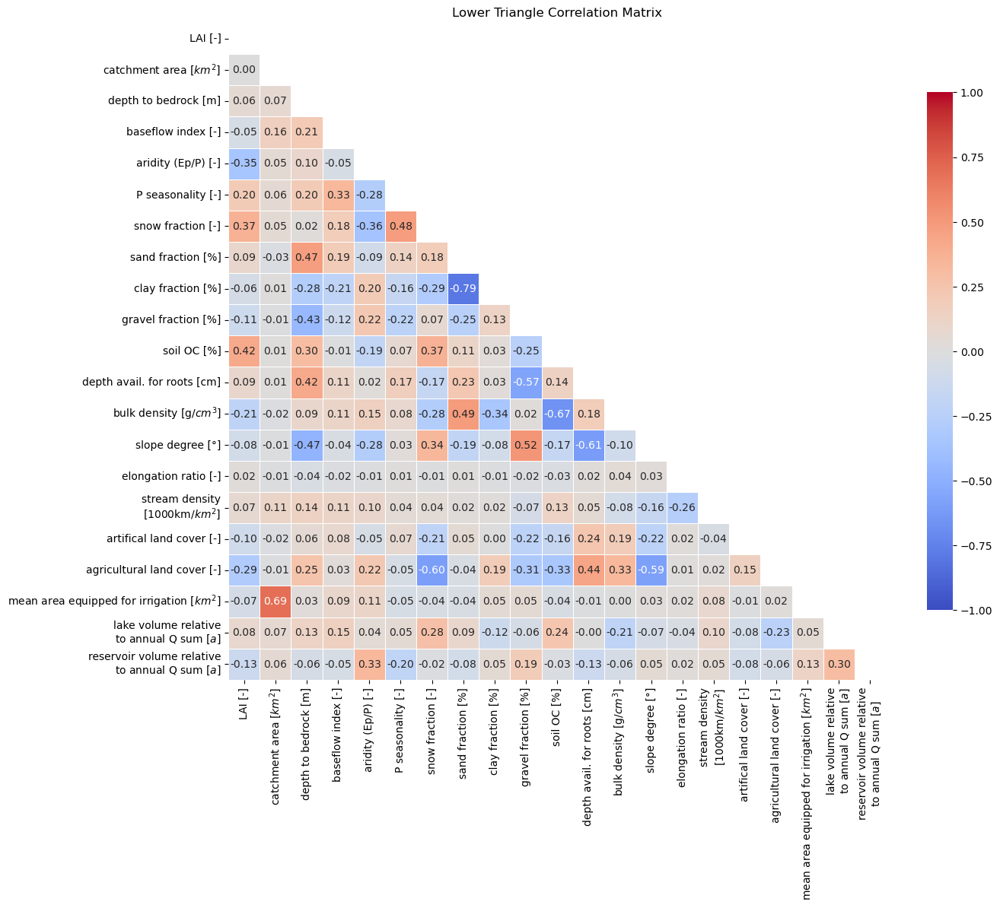

In [19]:
#QmaxPmeanTmean_Pelas
check_collinearity(elas=result_df_seasonal_mlr, cc=cc_df, Q_str='Qmax', P_str='Pmean', T_str='Tmean', met_type='P', t_scale='A')

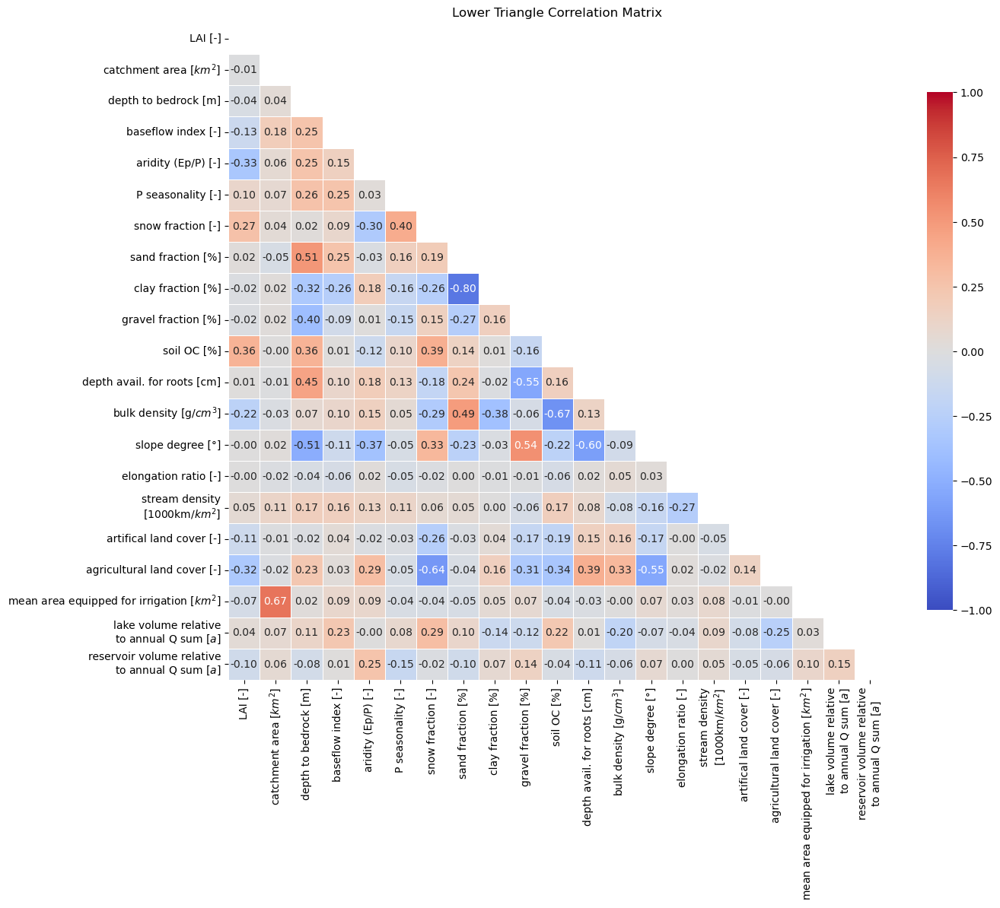

In [20]:
#QminPmeanTmean_Pelas
check_collinearity(elas=result_df_seasonal_mlr, cc=cc_df, Q_str='Qmin', P_str='Pmean', T_str='Tmean', met_type='P', t_scale='A')

# Calculate the Variance Inflation Factor (VIF)
VIF quantifies how much the variance of a regression coefficient is inflated due to multicollinearity.

**Interpretation:**

* VIF ≈ 1: No multicollinearity.

* VIF > 5: Moderate multicollinearity.

* VIF > 10: High multicollinearity — consider dropping or combining variables

In [21]:
def compute_VIF(elas, cc, Q_str, P_str, T_str, met_type, t_scale):
    elas = elas[['wkt_geometry',
                 str(Q_str+P_str+T_str+'_'+t_scale+'-'+met_dict[met_type]),
                 str(Q_str+P_str+T_str+'_'+t_scale+'-'+met_type+'_pval')]]
    
    # Extract only statistical significant ones
    elas = elas[elas[str(Q_str+P_str+T_str+'_'+t_scale+'-'+met_type+'_pval')]<0.05]
    
    elas = elas.dropna(subset=[str(Q_str+P_str+T_str+'_'+t_scale+'-'+met_dict[met_type])]) 
    
    elas, cc = elas.align(cc, join='inner', axis=0)
    X = cc # predictors (features)
    y = elas[str(Q_str+P_str+T_str+'_'+t_scale+'-'+met_dict[met_type])] # target variable
    
    # Split data into training and testing sets 
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, # e.g. 0.2: 80% train, 20% test
                                                        random_state=42) # sets a seed for Python's random number generator that always yields the same splitting data and allows to reproduce the exact results
    
    X_const = sm.add_constant(X_test)  # If needed
    vif_data = pd.DataFrame()
    vif_data['feature'] = X_const.columns
    vif_data['VIF'] = [variance_inflation_factor(X_const.values, i) for i in range(X_const.shape[1])]
    
    return vif_data

In [22]:
vif_QmeanPmeanTmean_Pelas = compute_VIF(elas=result_df_seasonal_mlr, cc=cc_df,
                                         Q_str='Qmean', P_str='Pmean', T_str='Tmean', met_type='P', t_scale='A')
vif_QmaxPmeanTmean_Pelas = compute_VIF(elas=result_df_seasonal_mlr, cc=cc_df,
                                         Q_str='Qmax', P_str='Pmean', T_str='Tmean', met_type='P', t_scale='A')
vif_QminPmeanTmean_Pelas = compute_VIF(elas=result_df_seasonal_mlr, cc=cc_df,
                                         Q_str='Qmin', P_str='Pmean', T_str='Tmean', met_type='P', t_scale='A')

In [23]:
vif_QmeanPmeanTmean_Pelas

,feature,VIF
0,const,653.806247
1,lai_mean,1.548356
2,area_estreams,2.546900
3,bedrk_dep,2.117048
4,baseflow_index,1.309742
5,aridity,1.993542
6,p_seasonality,1.826226
7,frac_snow,2.886083
8,soil_fra_sand_mean,7.991488
9,soil_fra_clay_mean,4.430691


In [24]:
vif_QmaxPmeanTmean_Pelas

,feature,VIF
0,const,468.827128
1,lai_mean,1.539044
2,area_estreams,1.508391
3,bedrk_dep,2.287743
4,baseflow_index,1.275132
5,aridity,2.021744
6,p_seasonality,2.047506
7,frac_snow,3.095671
8,soil_fra_sand_mean,7.490104
9,soil_fra_clay_mean,4.018376


In [25]:
vif_QminPmeanTmean_Pelas

,feature,VIF
0,const,682.491600
1,lai_mean,1.585009
2,area_estreams,2.003815
3,bedrk_dep,2.372223
4,baseflow_index,1.296993
5,aridity,1.877942
6,p_seasonality,1.657453
7,frac_snow,3.062442
8,soil_fra_sand_mean,8.393569
9,soil_fra_clay_mean,3.806081


In [26]:
# No value is over 10
#cc_df = cc_df.drop(columns=['soil_fra_sand_mean'])

# Choose Machine Learning model 

The choice of the model depends on the type of target variable:

- Regression: If the target variable is continuous.
- Classification: If the target variable is categorical.

Common models include:

- Regression: Linear Regression, Random Forest Regressor, XGBoost Regressor.
- Classification: Logistic Regression, Random Forest Classifier, XGBoost Classifier.

**We will continue with Random Forest Regressor.**

In [27]:
len(cc_df.columns)

21

# Random Forest Regression

In [28]:
param_grid = {
    'n_estimators': [200, 300, 500], # number of trees
    'max_depth': [10, 20, None], # maximum depth of each tree
    'min_samples_split': [2, 5, 10], # minimum samples required to split a node
    'min_samples_leaf': [1, 2, 5] # minimum samples required to be at a leaf node
}

In [29]:
def random_forest(elas, cc, Q_str, P_str, T_str, met_type, t_scale):
    elas = elas[['wkt_geometry', 
                 str(Q_str+P_str+T_str+'_'+t_scale+'-'+met_dict[met_type]), 
                 str(Q_str+P_str+T_str+'_'+t_scale+'-'+met_type+'_pval')]]
    
    # Extract only statistical significant ones
    elas = elas[elas[str(Q_str+P_str+T_str+'_'+t_scale+'-'+met_type+'_pval')]<0.05]
    
    elas = elas.dropna(subset=[str(Q_str+P_str+T_str+'_'+t_scale+'-'+met_dict[met_type])]) 
    
    elas, cc = elas.align(cc, join='inner', axis=0)
    X = cc # predictors (features)
    y = elas[str(Q_str+P_str+T_str+'_'+t_scale+'-'+met_dict[met_type])] # target variable
    
    # Split data into training and testing sets 
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, # e.g. 0.2: 80% train, 20% test
                                                        random_state=42) # sets a seed for Python's random number generator that always yields the same splitting data and allows to reproduce the exact results
    
    # Initialize the model
    rf = RandomForestRegressor(random_state=42)
    grid_search = GridSearchCV(rf, param_grid, cv=5, scoring='r2', n_jobs=-1, verbose=2)
    grid_search.fit(X_train, y_train)
    
    # Train the model using only the training data
    #rf.fit(X_train, y_train)
    
    best_params = grid_search.best_params_
    best_model = grid_search.best_estimator_
    
    print(f"Best parameters (train): {best_params}")
    print(f"Best CV score (train): {grid_search.best_score_:.3f}")
    
    # Predict on the test data
    y_pred = best_model.predict(X_test)

    # Evaluate the prediction
    mse = mean_squared_error(y_test, y_pred)
    r2 = r2_score(y_test, y_pred)
    print(f"Mean Squared Error: {mse:.3f}")
    print(f"R^2 Score: {r2:.3f}")
    
    # Alternatively cross-validate: Perform 5-fold cross-validation
    #cv_scores = cross_val_score(rf, X, y, cv=5, scoring='r2') # Using R² here, you can switch to 'neg_mean_squared_error'
    #print(f'Cross-validation scores: {np.round(cv_scores, 3)}')
    #print(f'Mean cross-validation score: {cv_scores.mean():.3f}')

    return best_model, X_test, y_test# rf, X_test, y_test # for feature importance add: X, X_train ##mse, r2#, cv_scores

In [30]:
%%time
rf_QmeanPmeanTmean_Pelas = random_forest(elas=result_df_seasonal_mlr, cc=cc_df,
                                         Q_str='Qmean', P_str='Pmean', T_str='Tmean', met_type='P', t_scale='A')
rf_QmaxPmeanTmean_Pelas = random_forest(elas=result_df_seasonal_mlr, cc=cc_df,
                                         Q_str='Qmax', P_str='Pmean', T_str='Tmean', met_type='P', t_scale='A')
rf_QminPmeanTmean_Pelas = random_forest(elas=result_df_seasonal_mlr, cc=cc_df,
                                         Q_str='Qmin', P_str='Pmean', T_str='Tmean', met_type='P', t_scale='A')

Fitting 5 folds for each of 81 candidates, totalling 405 fits
Best parameters (train): {'max_depth': None, 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 500}
Best CV score (train): 0.552
Mean Squared Error: 0.096
R^2 Score: 0.549
Fitting 5 folds for each of 81 candidates, totalling 405 fits
Best parameters (train): {'max_depth': 20, 'min_samples_leaf': 2, 'min_samples_split': 2, 'n_estimators': 500}
Best CV score (train): 0.507
Mean Squared Error: 0.266
R^2 Score: 0.524
Fitting 5 folds for each of 81 candidates, totalling 405 fits
Best parameters (train): {'max_depth': 20, 'min_samples_leaf': 2, 'min_samples_split': 2, 'n_estimators': 200}
Best CV score (train): 0.315
Mean Squared Error: 0.365
R^2 Score: 0.361
CPU times: user 45.4 s, sys: 884 ms, total: 46.3 s
Wall time: 17min 36s


In [31]:
# Prepare inputs #rf and X_test and y_test
rfs = list(zip([rf_QmeanPmeanTmean_Pelas[0], rf_QmaxPmeanTmean_Pelas[0], rf_QminPmeanTmean_Pelas[0]], 
               [rf_QmeanPmeanTmean_Pelas[1], rf_QmaxPmeanTmean_Pelas[1], rf_QminPmeanTmean_Pelas[1]],
               [rf_QmeanPmeanTmean_Pelas[2], rf_QmaxPmeanTmean_Pelas[2], rf_QminPmeanTmean_Pelas[2]]))

# Visualize results

## Feature Importance plot
For models like Random Forest or Gradient Boosting, you can directly obtain feature importance scores, which indicate how much each feature contributes to the model's predictions.

We plot the importances considering the sign of correlation.

In [32]:
import warnings
warnings.filterwarnings("ignore")

import logging
logging.getLogger('sklearn').setLevel(logging.ERROR)

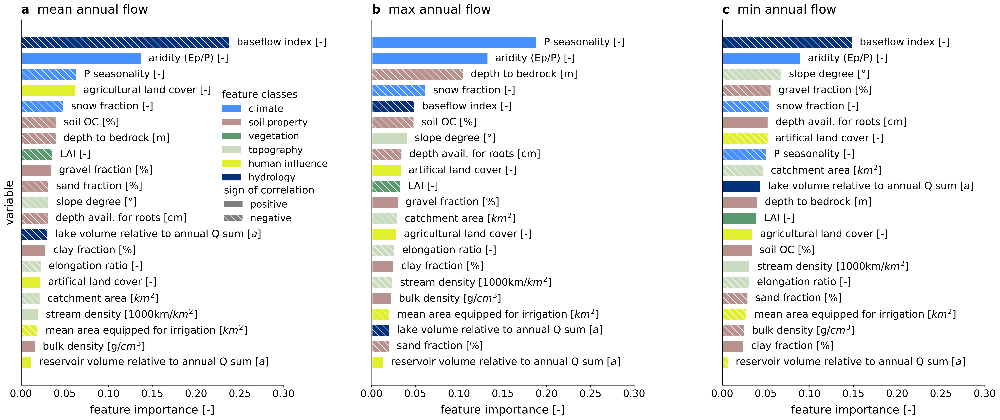

CPU times: user 2.85 s, sys: 2.73 s, total: 5.58 s
Wall time: 1.83 s


In [33]:
%%time

param_dict = {'q_runoff_ratio': 'Q runoff ratio [-]',
              'baseflow_index': 'baseflow index [-]', #'ratio of mean daily baseflow\nto mean daily Q [-]', 
              'q_elas_Sankarasubramanian': 'Q elasticity to P [-]', 
              'p_seasonality': 'P seasonality [-]',
              'aridity': 'aridity (Ep/P) [-]',
              'area_estreams':'catchment area [$km^2$]',
              'frac_snow': 'snow fraction [-]', 
              'lai_mean': 'LAI [-]', #'mean LAI [-]'
              'ndvi_mean': 'NDVI [-]', #'mean NDVI [-]'
              'soil_fra_sand_mean': 'sand fraction [%]', #'mean sand fraction [%]', 
              'soil_fra_clay_mean': 'clay fraction [%]', #'mean clay fraction [%]'
              'soil_fra_grav_mean': 'gravel fraction [%]', #'mean gravel fraction [%]'
              'soil_oc_mean': 'soil OC [%]', #'mean soil OC [%]'
              'root_dep_mean': 'depth avail. for roots [cm]', #'depth avail.for\nroots [cm]' #'mean root depth avail.\nfor roots [cm]'
              'soil_tawc_mean': 'total available water content [mm]', # 'total available\nwater content [mm]#'mean total available\nwater content [mm]
              'soil_bd_mean': 'bulk density [g/$cm^3$]', #'mean bulk density [g/$cm^3$]'
              'bedrk_dep': 'depth to bedrock [m]',
              'ele_mt_mean': 'elevation [m]', #'mean elevation [m]'
              'slp_dg_mean': 'slope degree [°]', #'mean slope degree [°]'
              'elon_ratio': 'elongation ratio [-]', # ratio between the diameter of a circle with the same area as the masin and the maximum length of the basin
              'flat_area_fra': 'flat area fraction [%]', 
              'steep_area_fra': 'steep area fraction [%]',
              'strm_dens': 'stream density [1000km/$km^2$]', #'stream density\n[1000km/$km^2$]'
              'dam_num': 'number of dams upstream [-]', #'number of dams\nupstream [-]'
              'res_num': 'number of reservoirs upstream [-]', 
              'res_tot_sto': 'total upstream storage volume [$10^6 m^3$]', 
              'lakes_tot_vol': 'total upstream volume (HydroLakes) [$10^6 m^3$]',
              'lakes_rel_vol': 'lake volume relative to annual Q sum [$a$]', #'lake volume relative\nto annual Q sum [$a$]
              'res_rel_vol': 'reservoir volume relative to annual Q sum [$a$]',
              'lulc_artif_mean': 'artifical land cover [-]', # 'artifical\nland cover [-]'#'mean artifical land cover [-]'
              'lulc_agri_mean': 'agricultural land cover [-]', # 'agricultural\nland cover [-]' #'mean agricultural land\ncover [-]'
              'irr_mean': 'mean area equipped for irrigation [$km^2$]'
             }

# Reverse mapping: pretty name → raw feature name
rev_param_dict = {v: k for k, v in param_dict.items()}

ft = 17
fig_letters = ['a', 'b', 'c']

def plot_feature_importance_sign(rfs, Q_strs, fnames, feature_name_dict=param_dict, 
                                     feature_class_dict=feature_class_dict, 
                                     class_color_dict=class_color_dict, met_type='P',
                                f_ext=''):
    met_title_dict = {'P': 'precipitation\nelasticity', 'T': 'temperature\nsensitivity'}
    
    fig, axes = plt.subplots(1, 3, figsize=(25, 10), dpi=300) #, sharey=True)
    fig.patch.set_alpha(0)
    plt.subplots_adjust(wspace=0.95)

    for j, (ax, rf_tuple, Q_str, fname) in zip(range(3), zip(axes, rfs, Q_strs, fnames)):
        rf, X_test, y_test = rf_tuple
        
        # Feature importance
        importances = rf.feature_importances_
        importance = pd.Series(importances, index=X_test.columns).sort_values(ascending=False)
        direction = X_test.corrwith(y_test).reindex(importance.index)
        feature_class = importance.index.map(feature_class_dict)
        
        # Build summary DataFrame
        summary_df = pd.DataFrame({
            'importance': importance,
            'direction': direction,
            'class': feature_class
        }).dropna()

        summary_df = summary_df.sort_values('importance', ascending=True)
        summary_df['signed_importance'] = summary_df['importance'] * np.sign(summary_df['direction'])
        
        # Plot figure
        for i, (idx, row) in enumerate(summary_df.iterrows()):
            
            color = class_color_dict.get(row['class'], 'black')
            hatch = None if row['signed_importance'] >= 0 else '\\\\' #'\\'
            ax.barh(i, row['importance'], color=color, edgecolor='white', hatch=hatch, linewidth=3)
            ax.text(row['importance'] + 0.008, i, feature_name_dict.get(idx, idx), va='center', ha='left', 
                    color='black', fontsize=ft)
        
        ax.set_yticks([])
        ax.set_title(fr'$\bf{{{fig_letters[j]}}}$  {Q_str}', fontsize=ft+4, loc='left', pad=10)
        ax.set_xlabel("feature importance [-]", fontsize=ft+2, labelpad=10)
        
        if ax is axes[0]:
            ax.set_ylabel("variable", fontsize=ft+2, labelpad=10)
        else:
            ax.set_ylabel("")
        ax.tick_params(labelsize=ft)
        for spine in ax.spines.values(): 
            spine.set_visible(False)
        ax.axvline(x=0, color='black', linewidth=2)
        ax.spines[['bottom']].set_visible(True)
        
    for ax in axes:
        ax.set_xlim(0, 0.3)
    
    class_legend = [
        Patch(facecolor=color, edgecolor='none', label=class_name)
        for class_name, color in class_color_dict.items()
    ]
    direction_legend = [
        Patch(facecolor='gray', edgecolor='white', hatch=None, label='positive'),
        Patch(facecolor='gray', edgecolor='white', hatch='\\\\', label='negative')
    ]
    
    anchor_x = 1.2

    legend1 = axes[0].legend(
        handles=class_legend,
        title='feature classes',
        loc='upper right',        # try 'upper left', 'lower left', etc.
        bbox_to_anchor=(anchor_x, 0.83),  # fine-tune position
        frameon=False,
        fontsize=16,
        title_fontsize=ft,
        alignment='left'
    )
    axes[0].add_artist(legend1)

    legend2 = axes[0].legend(
        handles=direction_legend,
        title='sign of correlation',
        loc='lower right',       # independent placement
        bbox_to_anchor=(anchor_x-0.05, 0.42),
        frameon=False,
        fontsize=16,
        title_fontsize=ft,
        alignment='left'
    )
    
    plt.tight_layout()
    fig.savefig(fp_figures/f"04_attribution/feature_importance_class_sign{f_ext}.png", bbox_inches='tight')
    fig.savefig(fp_figures/f"04_attribution/feature_importance_class_sign{f_ext}.pdf", bbox_inches='tight')
    plt.show()

plot_feature_importance_sign(rfs=rfs, Q_strs=['mean annual flow', 'max annual flow', 'min annual flow'], 
                             fnames=['Qmean', 'Qmax', 'Qmin'])

## Comparison to feature importance when excluding baseflow index or only using baseflow index

In [34]:
%time
cc_df_nobfi = cc_df.drop(columns='baseflow_index')
rf_QmeanPmeanTmean_Pelas_nobfi = random_forest(elas=result_df_seasonal_mlr, cc=cc_df_nobfi,
                                         Q_str='Qmean', P_str='Pmean', T_str='Tmean', met_type='P', t_scale='A')
rf_QmaxPmeanTmean_Pelas_nobfi = random_forest(elas=result_df_seasonal_mlr, cc=cc_df_nobfi,
                                         Q_str='Qmax', P_str='Pmean', T_str='Tmean', met_type='P', t_scale='A')
rf_QminPmeanTmean_Pelas_nobfi = random_forest(elas=result_df_seasonal_mlr, cc=cc_df_nobfi,
                                         Q_str='Qmin', P_str='Pmean', T_str='Tmean', met_type='P', t_scale='A')


# Prepare inputs #rf and X_test and y_test
rfs_nobfi = list(zip([rf_QmeanPmeanTmean_Pelas_nobfi[0], rf_QmaxPmeanTmean_Pelas_nobfi[0], rf_QminPmeanTmean_Pelas_nobfi[0]], 
                    [rf_QmeanPmeanTmean_Pelas_nobfi[1], rf_QmaxPmeanTmean_Pelas_nobfi[1], rf_QminPmeanTmean_Pelas_nobfi[1]],
                    [rf_QmeanPmeanTmean_Pelas_nobfi[2], rf_QmaxPmeanTmean_Pelas_nobfi[2], rf_QminPmeanTmean_Pelas_nobfi[2]]))

CPU times: user 1e+03 ns, sys: 0 ns, total: 1e+03 ns
Wall time: 3.1 µs
Fitting 5 folds for each of 81 candidates, totalling 405 fits
Best parameters (train): {'max_depth': None, 'min_samples_leaf': 2, 'min_samples_split': 2, 'n_estimators': 500}
Best CV score (train): 0.463
Mean Squared Error: 0.120
R^2 Score: 0.434
Fitting 5 folds for each of 81 candidates, totalling 405 fits
Best parameters (train): {'max_depth': None, 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 300}
Best CV score (train): 0.500
Mean Squared Error: 0.272
R^2 Score: 0.514
Fitting 5 folds for each of 81 candidates, totalling 405 fits
Best parameters (train): {'max_depth': None, 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 500}
Best CV score (train): 0.278
Mean Squared Error: 0.391
R^2 Score: 0.316


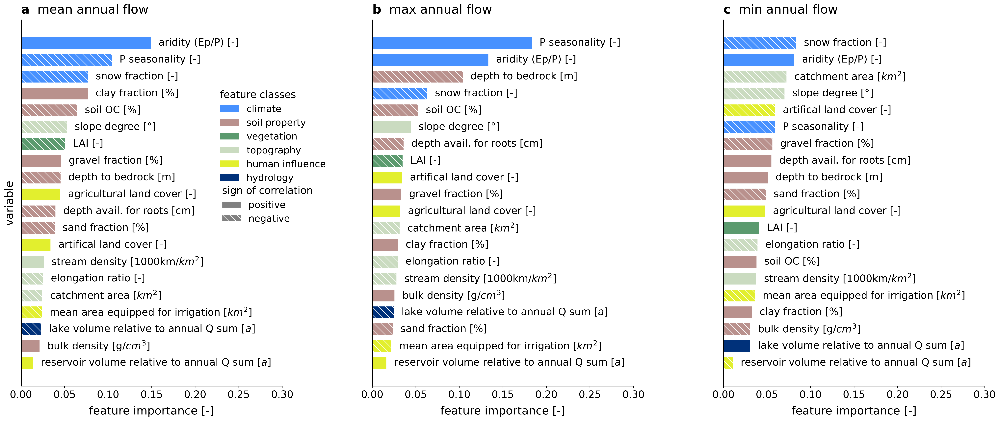

In [35]:
warnings.filterwarnings("ignore")
logging.getLogger('sklearn').setLevel(logging.ERROR)

plot_feature_importance_sign(rfs=rfs_nobfi, Q_strs=['mean annual flow', 'max annual flow', 'min annual flow'], 
                             fnames=['Qmean', 'Qmax', 'Qmin'], f_ext='_nobfi')

# Plot catchment characteristics in maps

Let's plot maps of the most highly ranked features:

Row 1: 
* 'p_seasonality': 'climate'
* 'aridity': 'climate'
* 'frac_snow': 'climate'
* 'lakes_rel_vol': 'hydrology'


Row 2: 
* 'elon_ratio': 'topography'
* 'slp_dg_mean': 'topography'
* 'area_estreams': 'topography'
* 'lai_mean': 'vegetation' 
   
    
Row 3:     
* 'bedrk_dep': 'soil property'
* 'soil_fra_sand_mean': 'soil property'
* 'soil_fra_grav_mean': 'soil property'
* 'soil_fra_clay_mean': 'soil property'


Row 4: 
* 'soil_oc_mean': 'soil property'
* 'root_dep_mean': 'soil property'  
* 'lulc_agri_mean': 'human influence'
* 'lulc_artif_mean': 'human influence'



Do not plot:
* 'baseflow_index': 'hydrology' --> not used anymore



* 'strm_dens': 'ecohydrology'
* 'irr_mean': 'human influence'
* 'soil_bd_mean': 'soil property'
* 'res_rel_vol': 'human influence'

In [36]:
warnings.filterwarnings("ignore")
logging.getLogger('sklearn').setLevel(logging.ERROR)

"""
    Plots 16 maps from columns in a GeoDataFrame using Cartopy and shared projection with individual colorbars.

    Parameters:
        gdf (GeoDataFrame): GeoDataFrame with point data and variables.
        var_list (list): List of 16 column names to plot.
        cmap (str or Colormap): Colormap for points.
 """

ft = 16
europe_extent = [-9.5, 25, 36.7, 71]
prj = ccrs.LambertAzimuthalEqualArea(central_longitude=7, central_latitude=53) #(central_longitude=9, central_latitude=54) 
gdf = result_gdf.merge(cc_df, on='basin_id', how='inner')
gdf_proj = gdf.to_crs(prj)
extent_crs = ccrs.PlateCarree()
    
cmap=cm.batlow

ncols=4
nrows=4
# Layout config
map_w = 8.5
cbar_w = 0.3
pad_w = 0.5
total_w = cbar_w + ncols * map_w #+ pad_w
map_h = 9.7 #map_w / aspect_ratio
total_h = map_h * nrows 


#fig, axes = plt.subplots(nrows=nrows, ncols=ncols,figsize=(total_w, total_h),subplot_kw={'projection': prj_lambert},constrained_layout=True)
fig = plt.figure(figsize=(total_w, total_h), dpi=300) #fig = plt.figure(figsize=(map_w, map_h), dpi=300)
fig.patch.set_alpha(0)

gs = GridSpec(nrows, ncols, figure=fig, wspace=0.05, hspace=0.05) #width_ratios=ws, wspace=0.05)

var_list = ['p_seasonality', 'aridity', 'frac_snow', 'lakes_rel_vol',
            'slp_dg_mean', 'area_estreams', 'elon_ratio', 'lai_mean',
            'bedrk_dep', 'soil_fra_sand_mean', 'soil_fra_grav_mean', 'soil_fra_clay_mean', 
            'soil_oc_mean', 'root_dep_mean', 'lulc_agri_mean', 'lulc_artif_mean']

for i, var in enumerate(var_list):
    ax = fig.add_subplot(gs[i], projection=prj)
    ax.set_extent(europe_extent, crs=extent_crs)
    ax.set_aspect('auto')
    ax.set_facecolor('white')

    europe.boundary.plot(ax=ax, transform=extent_crs, facecolor='#6B6C6D',
                     edgecolor='dimgray', linewidth=0.8, alpha=0.5, zorder=0)

    # Default
    vmin, vmax = gdf_proj[var].min(), gdf_proj[var].max()
    norm = Normalize(vmin=vmin, vmax=vmax)
    use_log = False
    cap_value = None

    # Use log scaling and max values for some plots
    eps = 1e-6
    if i == 3: # log scale but normal max
        vmin = gdf_proj[var].min() + eps
        norm = LogNorm(vmin=vmin, vmax=vmax)
    elif i == 5: # log scale and defined max
        vmin = gdf_proj[var].min() + eps
        cap_value = 1e5   # <-- set cap
        norm = LogNorm(vmin=vmin, vmax=cap_value)
        
    elif i == 8: # normal scale and defined max
        cap_value = 40  # <-- set cap
        norm = Normalize(vmin=vmin, vmax=cap_value)
        
    # --- plot and grab the mappable ---
    gdf_proj.plot(
        column=var, ax=ax,
        markersize=4, marker='^',
        cmap=cmap, legend=True,
        legend_kwds={'shrink': 0.9, 'pad': 0.04},
        norm=norm, zorder=1
    )
    
    # grab the last colorbar created by GeoPandas
    cb_ax = fig.axes[-1]
    
    # loop over children of the colorbar axis to find the Colorbar object
    for child in cb_ax.get_children():
        if isinstance(child, Colorbar):
            cb = child
            break
    else:
        cb = None  # fallback
    
    # now safely modify ticks if capped
    if cap_value is not None and cb is not None:
        
        # Get top of the colorbar in data coordinates
        ylim = cb_ax.get_ylim()  # y-axis range of the colorbar
        top = ylim[1]             # maximum value

        # Place a text label slightly above the top
        cb_ax.text(0.5, top, f"\u2265{int(cap_value)}", ha='center', va='bottom',
                   fontsize=ft, transform=cb_ax.transData)

        
    cb_ax.tick_params(labelsize=ft)
        
    gl = ax.gridlines(extent_crs, draw_labels=True, linewidth=1, 
                      color='lightgray', linestyle='--')
    gl.xlocator = ticker.MultipleLocator(10)
    gl.ylocator = ticker.MultipleLocator(10)
    gl.xlabel_style = {'size': ft-2}
    gl.ylabel_style = {'size': ft-2}
    
    gl.top_labels = gl.right_labels = False
    if i > 7:
        gl.bottom_labels = True
    else:
        gl.bottom_labels = False
    
    if i in [0, 4, 8, 12]:
        gl.left_labels = True
    else:
        gl.left_labels = False

    # Title
    ax.set_title(param_dict[var], fontsize=ft+4, pad=14)

fig.savefig(fp_figures/"04_attribution/catchment_characteristics_maps.png", dpi=300, bbox_inches='tight')  
fig.savefig(fp_figures/"04_attribution/catchment_characteristics_maps.pdf", bbox_inches='tight')  
plt.show()